In [1]:
import tensorflow as tf
import tensorflow_hub as hub
from tensorflow_docs.vis import embed
import numpy as np
import cv2

from matplotlib import pyplot as plt
from matplotlib.collections import LineCollection
import matplotlib.patches as patches

import imageio
from IPython.display import HTML, display

2024-03-05 17:48:34.640071: I external/local_tsl/tsl/cuda/cudart_stub.cc:31] Could not find cuda drivers on your machine, GPU will not be used.
2024-03-05 17:48:34.795207: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-03-05 17:48:34.795272: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-03-05 17:48:34.816143: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-03-05 17:48:34.870858: I external/local_tsl/tsl/cuda/cudart_stub.cc:31] Could not find cuda drivers on your machine, GPU will not be used.
2024-03-05 17:48:34.872119: I tensorflow/core/platform/cpu_feature_guard.cc:1

In [2]:
# Dictionary that maps from joint names to keypoint indices
KEYPOINT_DICT = {
    'nose': 0,
    'left_eye': 1,
    'right_eye': 2,
    'left_ear': 3,
    'right_ear': 4,
    'left_shoulder': 5,
    'right_shoulder': 6,
    'left_elbow': 7,
    'right_elbow': 8,
    'left_wrist': 9,
    'right_wrist': 10,
    'left_hip': 11,
    'right_hip': 12,
    'left_knee': 13,
    'right_knee': 14,
    'left_ankle': 15,
    'right_ankle': 16
}

# Map bones to a matplotlib color name
KEYPOINT_EDGE_INDS_TO_COLOR = {
    (0, 1): 'm',
    (0, 2): 'c',
    (1, 3): 'm',
    (2, 4): 'c',
    (0, 5): 'm',
    (0, 6): 'c',
    (5, 7): 'm',
    (7, 9): 'm',
    (6, 8): 'c',
    (8, 10): 'c', 
    (5, 6): 'y',
    (5, 11): 'm',
    (6, 12): 'c',
    (11, 12): 'y', 
    (11, 13): 'm', 
    (13, 15): 'm',
    (12, 14): 'c',
    (14, 16): 'c'
}

def _keypoints_and_edges_for_display(keypoints_with_scores, height, width, keypoint_threshold=0.11):
    """Return high confidence keypoints and edges for visualization.
    Args: 
        keypoints_with_scores: A numpy array with shape [1, 1, 17, 3]
        representing the keypoint coordinates and scores returned from the MoveNet model.
        Input:
        height: of the image
        width: of the image
        keypoint_threshold: minimum confidence score

        Return:
        coordinates of all keypoints
        coordinates of all skeleton edges
        colors of edges
        """
    keypoints_all = []
    keypoint_edges_all = []
    edge_colors = []
    num_instances, _, _, _ = keypoints_with_scores.shape
    for idx in range(num_instances):
        kpts_x = keypoints_with_scores[0, idx, :, 1]
        kpts_y = keypoints_with_scores[0, idx, :, 0]
        kpts_scores = keypoints_with_scores[0, idx, :, 2]
        kpts_absolute_xy = np.stack([width *np.array(kpts_x), height*np.array(kpts_y)], axis = -1)
        kpts_above_thresh_absolute = kpts_absolute_xy[kpts_scores > keypoint_threshold, :]
        keypoints_all.append(kpts_above_thresh_absolute)

        for edge_pair, color in KEYPOINT_EDGE_INDS_TO_COLOR.items():
            if(kpts_scores[edge_pair[0]] > keypoint_threshold and 
               kpts_scores[edge_pair[1]] > keypoint_threshold):
                x_start = kpts_absolute_xy[edge_pair[0], 0]
                y_start = kpts_absolute_xy[edge_pair[0], 1]
                x_end = kpts_absolute_xy[edge_pair[1], 0]
                y_end = kpts_absolute_xy[edge_pair[1], 1]

                line_seg = np.array([[x_start, y_start], [x_end, y_end]])
                keypoint_edges_all.append(line_seg)
                edge_colors.append(color)
    
    if keypoints_all:
        keypoints_xy = np.concatenate(keypoints_all, axis = 0)
    else:
        keypoints_xy = np.zeros((0, 17, 2)) # there is no detected person
    
    if keypoint_edges_all:
        edges_xy = np.stack(keypoint_edges_all, axis = 0)
    else:
        edges_xy = np.zeros((0, 2, 2))
    return keypoints_xy, edges_xy, edge_colors
    

In [3]:
def draw_prediction_on_image(
        image, keypoints_with_scores, crop_region = None, close_figure=False,
        output_image_height = None
):
    """Draws the keypoint predictions on image.
    
    Args:
        image: A  numpy array 
        kepoints_with_scores
        crop_region: A dictionary that defines the coordinates of the bounding box of 
        the crop region in normalized coordinates
        output_image_height: An integer indicating the height of the output image
        (The image aspect ratio will be the same as the input image)
    Return :
        an array with shape [out_height, out_width, channel] representing the image"""
    height, width, channel = image.shape 
    aspect_ratio = float(width) / height 
    fig, ax = plt.subplots(figsize = (12 * aspect_ratio, 12))
    
    # To remove the huge white borders
    fig.tight_layout(pad = 0)
    ax.margins(0)
    ax.set_yticklabels([])
    ax.set_xticklabels([])
    plt.axis('off')

    im = ax.imshow(image)
    line_segments = LineCollection([], linewidths = (4), linestyle = 'solid')
    ax.add_collection(line_segments)
    # Turn off tick labels
    scat = ax.scatter([], [], s = 60, color = '#FF1493', zorder=3)

    (keypoints_locs, keypoint_edges, edge_colors) = _keypoints_and_edges_for_display(keypoints_with_scores, height, width)
    

    # line_segments.set_segments(keypoint_edges)
    # line_segments.set_color(edge_colors)
    if keypoint_edges.shape[0]:
        line_segments.set_segments(keypoint_edges)
        line_segments.set_color(edge_colors)
    if keypoints_locs.shape[0]:
        scat.set_offsets(keypoints_locs)

    if crop_region is not None:
        xmin = max(crop_region['x_min']*width, 0.0)
        ymin = max(crop_region['y_min']*height, 0.0)
        rec_width = min(crop_region['x_max'], 0.99)*width - xmin
        rec_height = min(crop_region['y_max'], 0.99)*height - ymin

        rect = patches.Rectangle(
            (xmin, ymin), rec_width, rec_height,
            linewidth = 1, edgecolor = 'b', facecolor = 'none'
        )
        ax.add_patch(rect)

    fig.canvas.draw()
    image_from_plot = np.frombuffer(fig.canvas.tostring_rgb(), dtype = np.uint8)
    image_from_plot = image_from_plot.reshape(
        fig.canvas.get_width_height()[::-1]+(3,))
    plt.close(fig)

    if output_image_height is not None:
        output_image_width = int(output_image_height/height * width)
        image_from_plot = cv2.resize(
            image_from_plot, dsize = (output_image_width, output_image_height),
            interpolation=cv2.INTER_CUBIC
        )
    return image_from_plot 




In [4]:
def to_gif(images, fps):
    """Converts image sequence (4D numpy array) to gif"""
    imageio.mimsave('./output/animation.gif', images, fps = fps)
    return embed.embed_file('./output/animation.gif')

In [5]:
def progress(value, max = 100):
    return HTML("""
                <progress
                    value = '{value}'
                    max = '{max}',
                    style = 'width: 100%'
                >
                    {value}
                </progress>
    """.format(value = value, max = max))

### Load Model from TF hub

In [6]:
model_name = "tflite_movenet_thunder_f16" #@param ["movenet_lightning", "movenet_thunder", "movenet_lightning_f16.tflite", "movenet_thunder_f16.tflite",
# "movenet_lightning_int8.tflite", "movenet_thunder_int8.tflite"]

if "tflite" in model_name:
    if "movenet_lightning_f16" in model_name:
        !wget -q -O model.tflite https://tfhub.dev/google/lite-model/movenet/singlepose/lightning/tflite/float16/4?lite-format=tflite
        input_size = 192
    elif "movenet_thunder_f16" in model_name:
        !wget -q -O model.tflite https://tfhub.dev/google/lite-model/movenet/singlepose/thunder/tflite/float16/4?lite-format=tflite
        input_size = 256
    elif "movenet_lightning_int8" in model_name:
        !wget -q -O model.tflite https://tfhub.dev/google/lite-model/movenet/singlepose/lightning/tflite/int8/4?lite-format=tflite
        input_size = 192
    elif "movenet_thunder_int8" in model_name:
        !wget -q -O model.tflite https://tfhub.dev/google/lite-model/movenet/singlepose/thunder/tflite/int8/4?lite-format=tflite
        input_size = 256
    else:
        raise ValueError("Unsupported model name: %s" %model_name)
    
    # Initialize the TFlite interpretter
    interpretter = tf.lite.Interpreter(model_path='model.tflite')
    interpretter.allocate_tensors()

    def movenet(input_image):
        """Runs detection on an input image.
        Args:
            input_image: A [1, height, width, 3] tensor represents the input image pixels
            Returns:
                A [1, 1, 17 3] float numpy array representing the predicted keypoint coordinates and scores"""
        # TF Lite format expects tensor type of unit8
        input_image = tf.cast(input_image, dtype = tf.uint8)
        input_details = interpretter.get_input_details()
        output_details = interpretter.get_output_details()
        interpretter.set_tensor(input_details[0]['index'], input_image._numpy())

        # Invoke inference
        interpretter.invoke()
        # Get the model prediction
        keypoints_with_scores = interpretter.get_tensor(output_details[0]['index'])
        return keypoints_with_scores
    
else: 
    if "movenet_lightning" in model_name:
        module = hub.load("https://tfhub.dev/google/movenet/singlepose/lightning/4")
        input_size = 192
    elif "movenet_thunder" in model_name:
        module = hub.load("https://tfhub.dev/google/movenet/singlepose/thunder/4")
        input_size = 256
    else:
        raise ValueError("Unsupported model name: %s" % model_name)
    
    def movenet(input_image):
        model = module.signatures['serving_default']

        # SaveModel format expects tensor type of int 32
        input_image = tf.cast(input_image, dtype = tf.int32)
        # Run model inference
        outputs = model(input_image)
        # Output is a [1, 1, 17, 3] tensor
        keypoints_with_scores = outputs['output_0'].numpy()
        return keypoints_with_scores









INFO: Created TensorFlow Lite XNNPACK delegate for CPU.


### Single Image Example 

This session demonstrates the minimum working example of running the model on a snigle image to predict the 17 human keypoints

In [7]:
!curl -o images/input_image.jpeg https://images.pexels.com/photos/4384679/pexels-photo-4384679.jpeg --silent

In [8]:
# Load the input image
image_path = "./images/boy.jpeg"
image = tf.io.read_file(image_path)
image = tf.image.decode_jpeg(image)

2024-03-05 17:48:56.615613: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-03-05 17:48:56.617407: W tensorflow/core/common_runtime/gpu/gpu_device.cc:2256] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


### Run Inference

/tmp/ipykernel_2948/748194110.py:57: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed two minor releases later. Use buffer_rgba instead.
  image_from_plot = np.frombuffer(fig.canvas.tostring_rgb(), dtype = np.uint8)


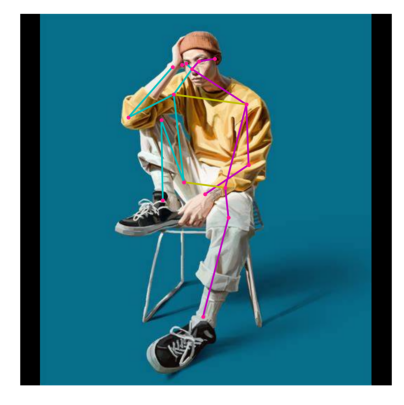

In [9]:
# Resize and pad the image to keep the aspect ratio fit the expected size
input_image = tf.expand_dims(image, axis = 0)
input_image = tf.image.resize_with_pad(input_image, input_size, input_size)

# Run model inference
keypoints_with_scores = movenet(input_image)

# Visualize the predictions with image
display_image = tf.expand_dims(image, axis = 0)
display_image = tf.cast(tf.image.resize_with_pad(
    display_image, 1280, 1280), dtype = tf.int32)

output_overlay = draw_prediction_on_image(
    np.squeeze(display_image.numpy(), axis = 0), keypoints_with_scores
)

plt.figure(figsize=(5,5))
plt.imshow(output_overlay)
_ = plt.axis('off')

## Video Example

In [10]:
#@title Cropping Algorithm
# Confidence score to determine whether a keypoint prediction is reliable
MIN_CROP_KEYPOINT_SCORE =  0.2

def init_crop_region(image_height, image_width):
    """Define th default crop region
    The function provides the initial crop region (pads the full image from both sides
    to make it a square image) when the algorithm cannot reliably determine the crop 
    region from the previous frame"""

    if image_width > image_height:
        box_height = image_width/image_height
        box_width = 1.0
        y_min = (image_height / 2 - image_width / 2)/image_height
        x_min = 0.0

    else:
        box_height = 1.0
        box_width = image_height / image_width
        y_min = 0.0
        x_min = (image_width / 2 - image_height / 2)/ image_width 

    return {
        'y_min': y_min,
        'x_min': x_min,
        'y_max': y_min+box_height,
        'x_max': x_min+box_width,
        'height': box_height,
        'width': box_width
    }
def torso_visible(keypoints):
    """Checks whether there are enough torseo keypoints.
    This function checks whether the model is confident at predicting one of the
    shoulders/hips which is require to determine a good crop region"""

    return ((keypoints[0, 0, KEYPOINT_DICT['left_hip'], 2] > MIN_CROP_KEYPOINT_SCORE 
             or keypoints[0, 0, KEYPOINT_DICT['right_hip'], 2] > MIN_CROP_KEYPOINT_SCORE)
             and (keypoints[0, 0, KEYPOINT_DICT['left_shoulder'], 2] > MIN_CROP_KEYPOINT_SCORE
             or keypoints[0, 0, KEYPOINT_DICT['right_shoulder'], 2] > MIN_CROP_KEYPOINT_SCORE))

def determine_torso_and_body_range(keypoints, target_keypoints, center_y, center_x):
    """Calculates the maximum distance from each keypoints to center location
    The function return the maximum distances from the two sets of keypoints:
    full 17 keypoints and 4 torso keypoints. The returned information will be used to
    determined the crop size. See determineCropRegion for more detail."""

    torso_joints = ['left_shoulder', 'right_shoulder', 'left_hip', 'right_hip']
    max_torso_yrange = 0.0
    max_torso_xrange = 0.0
    for joint in torso_joints:
        dist_y = abs(center_y - target_keypoints[joint][0])
        dist_x = abs(center_x - target_keypoints[joint][1])
        if dist_y > max_torso_yrange:
            max_torso_yrange = dist_y
        if dist_x > max_torso_xrange:
            max_torso_xrange = dist_x

    max_body_yrange = 0.0
    max_body_xrange = 0.0
    for joint in KEYPOINT_DICT.keys():
        if keypoints[0, 0, KEYPOINT_DICT[joint], 2] < MIN_CROP_KEYPOINT_SCORE:
            continue
        dist_y = abs(center_y - target_keypoints[joint][0]);
        dist_x = abs(center_x - target_keypoints[joint][1]);
        if dist_y > max_body_yrange:
            max_body_yrange = dist_y

        if dist_x > max_body_xrange:
            max_body_xrange = dist_x

    return [max_torso_yrange, max_torso_xrange, max_body_yrange, max_body_xrange]

def determine_crop_region(
        keypoints, image_height,
        image_width
):
    """Determines the region to crop the image for the model to run inference on.
    The algorithm uses the detected joints from the previous frame to estimate
  the square region that encloses the full body of the target person and
  centers at the midpoint of two hip joints. The crop size is determined by
  the distances between each joints and the center point.
  When the model is not confident with the four torso joint predictions, the
  function returns a default crop which is the full image padded to square."""
    target_keypoints = {}
    for joint in KEYPOINT_DICT.keys():
        target_keypoints[joint] = [
            keypoints[0, 0, KEYPOINT_DICT[joint], 0] * image_height,
            keypoints[0, 0, KEYPOINT_DICT[joint], 1] * image_width
        ]
    
    if torso_visible(keypoints):
        center_y = (target_keypoints['left_hip'][0] +
                    target_keypoints['right_hip'][0])/2;
        center_x = (target_keypoints['left_hip'][1] +
                    target_keypoints['right_hip'][1])/2;

        (max_torso_yrange, max_torso_xrange,
        max_body_yrange, max_body_xrange) = determine_torso_and_body_range(
          keypoints, target_keypoints, center_y, center_x)

        crop_length_half = np.amax(
            [max_torso_xrange * 1.9, max_torso_yrange * 1.9,
            max_body_yrange * 1.2, max_body_xrange * 1.2])

        tmp = np.array(
            [center_x, image_width - center_x, center_y, image_height - center_y])
        crop_length_half = np.amin(
            [crop_length_half, np.amax(tmp)]);

        crop_corner = [center_y - crop_length_half, center_x - crop_length_half];

        if crop_length_half > max(image_width, image_height) / 2:
            return init_crop_region(image_height, image_width)
        else:
            crop_length = crop_length_half * 2;
            return {
                'y_min': crop_corner[0] / image_height,
                'x_min': crop_corner[1] / image_width,
                'y_max': (crop_corner[0] + crop_length) / image_height,
                'x_max': (crop_corner[1] + crop_length) / image_width,
                'height': (crop_corner[0] + crop_length) / image_height -
                    crop_corner[0] / image_height,
                'width': (crop_corner[1] + crop_length) / image_width -
                crop_corner[1] / image_width
      }
    else:
        return init_crop_region(image_height, image_width)

def crop_and_resize(image, crop_region, crop_size):
  """Crops and resize the image to prepare for the model input."""
  boxes=[[crop_region['y_min'], crop_region['x_min'],
          crop_region['y_max'], crop_region['x_max']]]
  output_image = tf.image.crop_and_resize(
      image, box_indices=[0], boxes=boxes, crop_size=crop_size)
  return output_image

def run_inference(movenet, image, crop_region, crop_size):
    """Runs model inference on cropped region.
    The function runs the model inference on the cropped region and update the model
    output to the original image coordinate system"""

    image_height, image_width, _ = image.shape 
    input_image = crop_and_resize(
        tf.expand_dims(image, axis = 0), crop_region, crop_size = crop_size)
    # Run model inference
    keypoints_with_scores = movenet(input_image)
    # Update the coordinates
    for idx in range(17):
        keypoints_with_scores[0, 0, idx, 0] = (
            crop_region['y_min'] * image_height + 
            crop_region['height'] * image_height *
            keypoints_with_scores[0, 0, idx, 0]
        ) / image_height
        keypoints_with_scores[0, 0, idx, 1] = (
        crop_region['x_min'] * image_width +
        crop_region['width'] * image_width *
        keypoints_with_scores[0, 0, idx, 1]) / image_width

    return keypoints_with_scores




### Load Input Image Sequence

In [11]:
!wget -q videos/dance.gif https://github.com/tensorflow/tfjs-models/raw/master/pose-detection/assets/dance_input.gif

### Run Inference with Cropping Algorithm

2024-03-05 17:49:04.117627: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 208742400 exceeds 10% of free system memory.


/tmp/ipykernel_2948/748194110.py:57: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed two minor releases later. Use buffer_rgba instead.
  image_from_plot = np.frombuffer(fig.canvas.tostring_rgb(), dtype = np.uint8)
/tmp/ipykernel_2948/748194110.py:57: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed two minor releases later. Use buffer_rgba instead.
  image_from_plot = np.frombuffer(fig.canvas.tostring_rgb(), dtype = np.uint8)
/tmp/ipykernel_2948/748194110.py:57: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed two minor releases later. Use buffer_rgba instead.
  image_from_plot = np.frombuffer(fig.canvas.tostring_rgb(), dtype = np.uint8)
/tmp/ipykernel_2948/748194110.py:57: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed two minor releases later. 


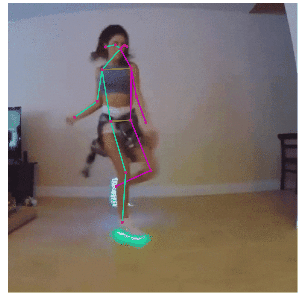

In [12]:
# Load the input image.
image_path = 'images/dancing_girl.gif'
image = tf.io.read_file(image_path)
image = tf.image.decode_gif(image)

num_frames, image_height, image_width, _ = image.shape
crop_region = init_crop_region(image_height, image_width)

output_images = []
bar = display(progress(0, num_frames- 1), display_id = True)
for frame_idx in range(num_frames):
    keypoints_with_scores = run_inference(
        movenet, image[frame_idx, :, :, :], crop_region,
        crop_size = [input_size, input_size]
    )

    output_images.append(draw_prediction_on_image(
        image[frame_idx, :, :, :].numpy().astype(np.int32),
        keypoints_with_scores, crop_region=None,
        close_figure=True, output_image_height=300
    ))
    crop_region = determine_crop_region(keypoints_with_scores, image_height, image_width)
    bar.update(progress(frame_idx, num_frames-1))

# Prepare gif visualization.
output = np.stack(output_images, axis = 0)
to_gif(output, fps = 10)